# BASELINE CODE/IDEA OF THE PROJECT:
This project is improved from the paper **"Digging Into Self-Supervised Monocular Depth Estimation" by Godard et al. (ICCV 2019). "** we examine the performance of a lightweight CNN-based encoder-decoder model inspired by
Monodepth2 and compare the Adam and SGD optimizers under
various learning rates and batch sizes using **Pytorch**. Initially, models were
trained on 2000 samples using 100, 200, 500, and 700 epochs in a separate file;
however, these settings led to overfitting. To mitigate this, we
expanded training to 10,000 samples and conducted experiments
using 5 and 12 epochs due to GPU constraints. We explored batch
sizes of 8, 16, and 50 (the latter only for 500 and 700 epochs) to
assess their impact on convergence stability and prediction
accuracy.


# DATASET LOAD
This part of code takes dataset directly from Kaggle and uses it for the project. This code block performs the necessary steps to access the dataset in Kagglehub.

In [ ]:
# using kaggle.json to download the dataset directly from Kaggle
from google.colab import files
files.upload()


Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"manishkumardk","key":"611a797d41679b76ca7a04d7cf6f02df"}'}

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json


In [ ]:
!pip install kagglehub


In [ ]:
#importing dataset from Kaggle
import kagglehub

path = kagglehub.dataset_download("soumikrakshit/nyu-depth-v2")
print("Path to dataset files:", path)


100%|██████████| 4.10G/4.10G [00:49<00:00, 89.7MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/soumikrakshit/nyu-depth-v2/versions/1


In [ ]:
import os

# checks the folder where the dataset is present and trying to access it.
base_path = "/root/.cache/kagglehub/datasets/soumikrakshit/nyu-depth-v2/versions/1"
for root, dirs, files in os.walk(base_path):
    print("Folder", root)
    for file in files:
        print("   --", file)
    break


for item in os.listdir(base_path):
    item_path = os.path.join(base_path, item)
    if os.path.isdir(item_path):
        print(f"Folder {item}/")
    else:
        print(f"File {item}")

data_path = os.path.join(base_path, "nyu_data/data")

for item in os.listdir(data_path):
    item_path = os.path.join(data_path, item)
    if os.path.isdir(item_path):
        print(f"Folder {item}/")
    else:
        print(f"File {item}")


Folder /root/.cache/kagglehub/datasets/soumikrakshit/nyu-depth-v2/versions/1
Folder nyu_data/
Folder nyu2_test/
Folder nyu2_train/
File nyu2_train.csv
File nyu2_test.csv


In [ ]:
import pandas as pd

csv_path = os.path.join(data_path, "nyu2_train.csv")
df = pd.read_csv(csv_path)

df.head()


,data/nyu2_train/living_room_0038_out/37.jpg,data/nyu2_train/living_room_0038_out/37.png
0,data/nyu2_train/living_room_0038_out/115.jpg,data/nyu2_train/living_room_0038_out/115.png
1,data/nyu2_train/living_room_0038_out/6.jpg,data/nyu2_train/living_room_0038_out/6.png
2,data/nyu2_train/living_room_0038_out/49.jpg,data/nyu2_train/living_room_0038_out/49.png
3,data/nyu2_train/living_room_0038_out/152.jpg,data/nyu2_train/living_room_0038_out/152.png
4,data/nyu2_train/living_room_0038_out/142.jpg,data/nyu2_train/living_room_0038_out/142.png


In [ ]:
!pip install pillow torchvision


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 62.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 50.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 39.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 81.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [ ]:
import os
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import torch


In [ ]:
import pandas as pd
csv_path = os.path.join(data_path, "nyu2_train.csv")
df = pd.read_csv(csv_path)
print(df.columns)


Index(['data/nyu2_train/living_room_0038_out/37.jpg', 'data/nyu2_train/living_room_0038_out/37.png'], dtype='object')


# **DATASET SAMPLE SIZE**
choosing 10,000 sample to train the model as we chose 2000 sample images which overfitted the model.

In [ ]:
import pandas as pd
import os


data_path = os.path.join(base_path, "nyu_data/data")


csv_path = os.path.join(data_path, "nyu2_train.csv")
NYU_df = pd.read_csv(csv_path, header=None, names=["rgb", "depth"])


NYU_df["rgb"] = NYU_df["rgb"].str.replace("data/", "", regex=False)
NYU_df["depth"] = NYU_df["depth"].str.replace("data/", "", regex=False)

#choosing 10,000 sample images to train the model
NYU_sampled_df = NYU_df.sample(n=10000, random_state=42)


NYU_sampled_csv_path = os.path.join(data_path, "nyu2_train_sampled.csv")
NYU_sampled_df.to_csv(NYU_sampled_csv_path, index=False)


# BASELINE CODE WITH AND WITHOUT CHANGES
In the mentioned paper , they have used KITTI datasets where as we have used a lighter version of NYU Depth V2 Dataset which has RGB images paired with depth maps  made available in the Kaggle.



In [ ]:
from torch.utils.data import Dataset
from PIL import Image
import torchvision.transforms as transforms
import torch

# defines a class to apply transformations to the input images in the dataset
class NYU_Depth_Dataset(Dataset):
    def __init__(self, csv_file, root_dir, transform_img=None, transform_depth=None):
        self.data = pd.read_csv(csv_file)
        self.root_dir = root_dir
        self.transform_img = transform_img
        self.transform_depth = transform_depth

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_path = os.path.join(self.root_dir, self.data.iloc[idx, 0])
        depth_path = os.path.join(self.root_dir, self.data.iloc[idx, 1])

        image = Image.open(img_path).convert("RGB")
        depth = Image.open(depth_path).convert("L")

        if self.transform_img:
            image = self.transform_img(image)
        if self.transform_depth:
            depth = self.transform_depth(depth)

        return image, depth


**TRANSFORMATIONS APPLIED TO THE INPUT IMAGES**

The functions image_transform and depth_transform to apply transformations the input images

In [ ]:
import torchvision.transforms as transforms

RGB_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

depth_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Lambda(lambda x: x.float())
])


In [ ]:
from torch.utils.data import DataLoader

#calling the dataset class to perform transformations
dataset = NYU_Depth_Dataset(
    csv_file=sampled_csv_path,
    root_dir=data_path,
    transform_img=RGB_transform,
    transform_depth=depth_transform
)


dataloader = DataLoader(dataset, batch_size=4, shuffle=True)


**PLOTING THE RGB AND DEPTH IMAGE**
The below code shows a sample of RGB and Depth image and displays it

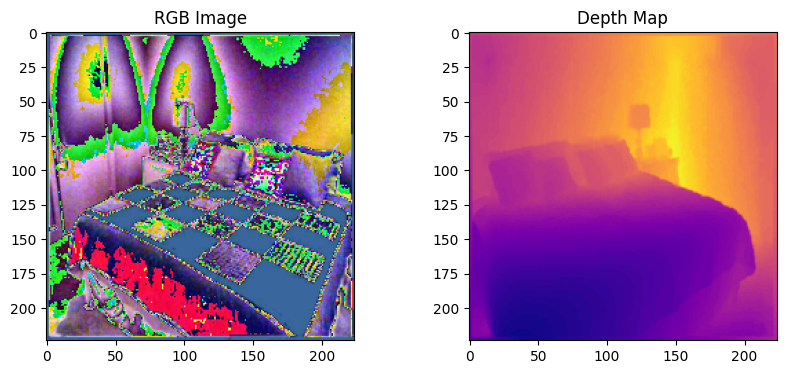

In [ ]:
import matplotlib.pyplot as plt
import torchvision.transforms.functional as F

images, depths = next(iter(dataloader))

def show_sample(image, depth):
    image = F.to_pil_image(image.cpu())
    depth = depth.squeeze().cpu().numpy()

    plt.figure(figsize=(10, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(image)
    plt.title("RGB Image")

    plt.subplot(1, 2, 2)
    plt.imshow(depth, cmap="plasma")
    plt.title("Depth Map")
    plt.show()


show_sample(images[0], depths[0])


**MODEL TRAINING**
The below code uses spatial attention class to focus on the significant spatial regions and the CNN module uses encoder and decoder module and then a forward pass is applied

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F


class Spatial_Attention(nn.Module):
    def __init__(self):
        super(Spatial_Attention, self).__init__()
        self.conv = nn.Conv2d(2, 1, kernel_size=7, padding=3)  # kernel size 7x7

    def forward(self, x):
        avg_out = torch.mean(x, dim=1, keepdim=True)
        max_out, _ = torch.max(x, dim=1, keepdim=True)
        concat = torch.cat([avg_out, max_out], dim=1)
        attention = torch.sigmoid(self.conv(concat))
        return x * attention

#  Implementation of CNN and Spatial Attention Depth Estimation
class CNN_Depth_Estimator(nn.Module):
    def __init__(self):
        super(CNNDepthEstimator, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=5, stride=2, padding=2),  # [B, 32, 112, 112]
            nn.BatchNorm2d(32),
            nn.ReLU(),
            SpatialAttention(),

            nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1),  # [B, 64, 56, 56]
            nn.BatchNorm2d(64),
            nn.ReLU(),
            SpatialAttention(),

            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),  # [B, 128, 28, 28]
            nn.BatchNorm2d(128),
            nn.ReLU()
        )

        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),

            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),

            nn.ConvTranspose2d(32, 1, kernel_size=4, stride=2, padding=1),
            nn.Sigmoid()

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x


In [ ]:
# checks if the model , loss and Adam Optimizer is ready
import torch.optim as optim


model = CNN_Depth_Estimator()


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)


criterion = nn.L1Loss()


optimizer = optim.Adam(model.parameters(), lr=1e-4)

print("Model, loss, and optimizer are ready.")


Model, loss, and optimizer are ready.


**MODEL TRAINING FUNCTION**

this code blocks defines a function to train the model

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import time


criterion = nn.MSELoss()


optimizer = optim.Adam(model.parameters(), lr=1e-4)


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)


def train_model(model, dataloader, criterion, optimizer, device, num_epochs=5):
    model.train()

    for epoch in range(num_epochs):
        epoch_loss = 0.0
        start_time = time.time()

        for batch_idx, (images, depths) in enumerate(dataloader):
            images = images.to(device)
            depths = depths.to(device)

            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, depths)
            loss.backward()
            optimizer.step()

            epoch_loss += loss.item()


            print(f"Epoch [{epoch+1}/{num_epochs}], Batch [{batch_idx+1}/{len(dataloader)}], Loss: {loss.item():.4f}")

        avg_loss = epoch_loss / len(dataloader)
        print(f"Epoch [{epoch+1}/{num_epochs}] - Avg Loss: {avg_loss:.4f} - Time: {time.time() - start_time:.2f}s\n")

    print("Training completed.")


train_model(model, dataloader, criterion, optimizer, device, num_epochs=20)


Streaming output truncated to the last 5000 lines.
Epoch [19/20], Batch [6/2500], Loss: 0.0279
Epoch [19/20], Batch [7/2500], Loss: 0.0142
Epoch [19/20], Batch [8/2500], Loss: 0.0122
Epoch [19/20], Batch [9/2500], Loss: 0.0083
Epoch [19/20], Batch [10/2500], Loss: 0.0217
Epoch [19/20], Batch [11/2500], Loss: 0.0147
Epoch [19/20], Batch [12/2500], Loss: 0.0065
Epoch [19/20], Batch [13/2500], Loss: 0.0181
Epoch [19/20], Batch [14/2500], Loss: 0.0213
Epoch [19/20], Batch [15/2500], Loss: 0.0107
Epoch [19/20], Batch [16/2500], Loss: 0.0193
Epoch [19/20], Batch [17/2500], Loss: 0.0126
Epoch [19/20], Batch [18/2500], Loss: 0.0245
Epoch [19/20], Batch [19/2500], Loss: 0.0245
Epoch [19/20], Batch [20/2500], Loss: 0.0187
Epoch [19/20], Batch [21/2500], Loss: 0.0146
Epoch [19/20], Batch [22/2500], Loss: 0.0246
Epoch [19/20], Batch [23/2500], Loss: 0.0128
Epoch [19/20], Batch [24/2500], Loss: 0.0110
Epoch [19/20], Batch [25/2500], Loss: 0.0387
Epoch [19/20], Batch [26/2500], Loss: 0.0137
Epoch [1

**MODEL EVALUATION**

This code evaluates the model and shows the input RGB and Depth image and the predicted output of this

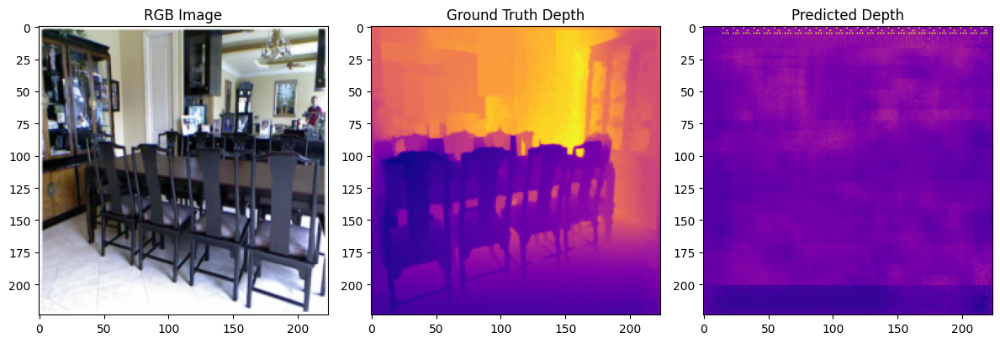

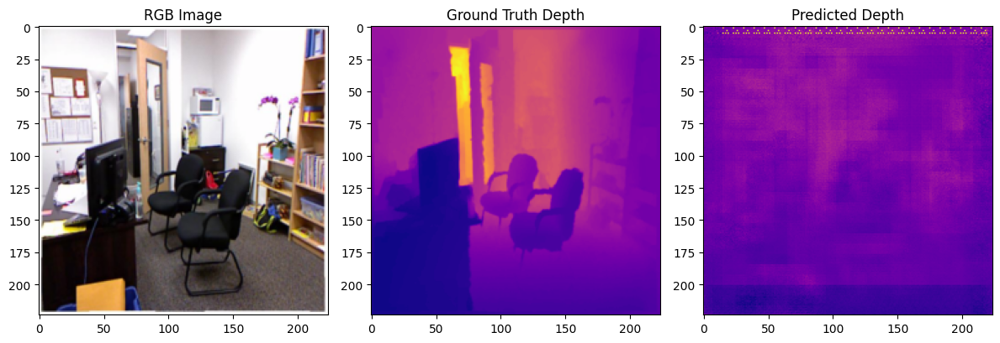

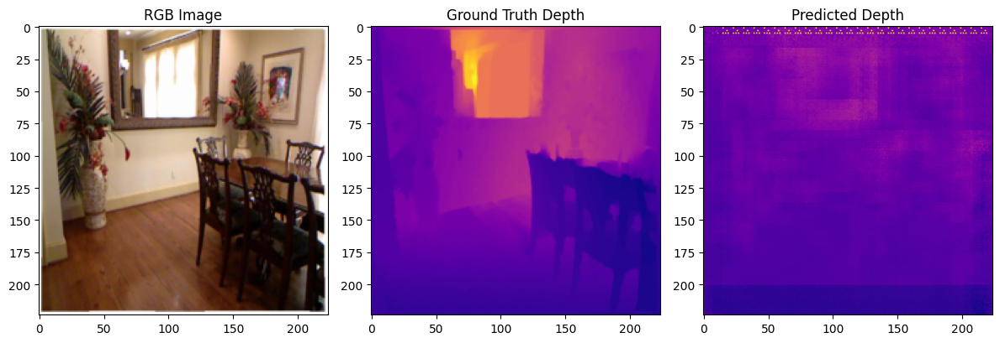

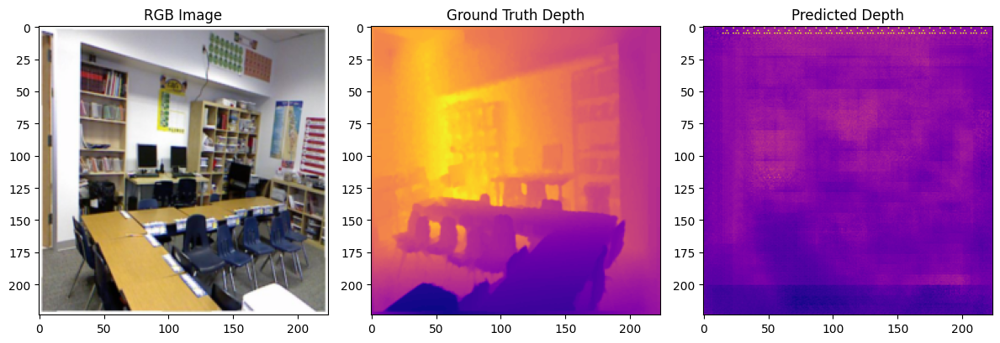

In [ ]:
import matplotlib.pyplot as plt
import torchvision.transforms.functional as TF
import torch


def unnormalize(img_tensor):
    mean = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)
    return img_tensor * std + mean


model.eval()


images, true_depths = next(iter(dataloader))
images = images.to(device)
true_depths = true_depths.to(device)

with torch.no_grad():
    predicted_depths = model(images)


images = images.cpu()
true_depths = true_depths.cpu()
predicted_depths = predicted_depths.cpu()

# plots the RGB, Depth and predicted image
for i in range(4):
    unnorm_img = unnormalize(images[i])
    rgb = TF.to_pil_image(torch.clamp(unnorm_img, 0, 1))
    true_depth = true_depths[i].squeeze().numpy()
    pred_depth = predicted_depths[i].squeeze().numpy()

    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(rgb)
    plt.title("RGB Image")

    plt.subplot(1, 3, 2)
    plt.imshow(true_depth, cmap="plasma")
    plt.title("Ground Truth Depth")

    plt.subplot(1, 3, 3)
    plt.imshow(pred_depth, cmap="plasma")
    plt.title("Predicted Depth")

    plt.tight_layout()
    plt.show()


# **HYPERPARAMETER TUNING**
From this , we have tried Adam , SGD optimiser , 8,16 batch sizes and epoch sizes such as 5,12 and plotted visualisation for this , we couldn't try 100, 200, 500, and 700 epochs for these 10,000 sample images as these settings will crash GPU and also led to overfitting

**BASELINE CODE WITH AND WITHOUT CHANGES:**

In the paper , they have used only Adam optimiser , but we have used Adam and  SGD optimiser

**ADAM AND SGD OPTIMISER FOR 5 EPOCHS AND BATCH SIZE 8**

In [ ]:
#this code below trains and evaluates the model for 5 epochs for Adam and SGD optimiser and shows the results in tensorboard
from torch.utils.data import DataLoader, random_split
from torch.utils.tensorboard import SummaryWriter
import torch
import torch.nn as nn
import torch.optim as optim
import time




train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

batch_size = 8
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size)


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
criterion = nn.MSELoss()


def train_model_tensorboard(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=5, optimizer_name="adam", batch_size=8):
    log_dir = f"runs/depth_{optimizer_name}_bs{batch_size}"
    writer = SummaryWriter(log_dir=log_dir)

    model.train()
    model.to(device)

    for epoch in range(num_epochs):
        train_loss = 0.0
        start_time = time.time()

        model.train()
        for images, depths in train_loader:
            images, depths = images.to(device), depths.to(device)

            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, depths)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        avg_train_loss = train_loss / len(train_loader)
        writer.add_scalar("Loss/train", avg_train_loss, epoch)


        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for images, depths in val_loader:
                images, depths = images.to(device), depths.to(device)
                outputs = model(images)
                loss = criterion(outputs, depths)
                val_loss += loss.item()

        avg_val_loss = val_loss / len(val_loader)
        writer.add_scalar("Loss/val", avg_val_loss, epoch)

        print(f"[{optimizer_name.upper()}] Epoch [{epoch+1}/{num_epochs}] - Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f} | Time: {time.time() - start_time:.2f}s")

    writer.close()
    print(" Training completed and TensorBoard logs saved.")


model = CNNDepthEstimator().to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-4)
train_model_tensorboard(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=5, optimizer_name="adam", batch_size=8)

model = CNNDepthEstimator().to(device)
optimizer = optim.SGD(model.parameters(), lr=1e-3, momentum=0.9)
train_model_tensorboard(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=5, optimizer_name="SGD", batch_size=8)


[ADAM] Epoch [1/5] - Train Loss: 0.0233 | Val Loss: 0.0202 | Time: 125.17s
[ADAM] Epoch [2/5] - Train Loss: 0.0203 | Val Loss: 0.0198 | Time: 118.62s
[ADAM] Epoch [3/5] - Train Loss: 0.0196 | Val Loss: 0.0193 | Time: 118.27s
[ADAM] Epoch [4/5] - Train Loss: 0.0193 | Val Loss: 0.0190 | Time: 118.49s
[ADAM] Epoch [5/5] - Train Loss: 0.0190 | Val Loss: 0.0187 | Time: 118.28s
 Training completed and TensorBoard logs saved.
[SGD] Epoch [1/5] - Train Loss: 0.0383 | Val Loss: 0.0270 | Time: 118.66s
[SGD] Epoch [2/5] - Train Loss: 0.0258 | Val Loss: 0.0248 | Time: 118.74s
[SGD] Epoch [3/5] - Train Loss: 0.0244 | Val Loss: 0.0240 | Time: 118.31s
[SGD] Epoch [4/5] - Train Loss: 0.0238 | Val Loss: 0.0234 | Time: 118.01s
[SGD] Epoch [5/5] - Train Loss: 0.0234 | Val Loss: 0.0230 | Time: 116.22s
 Training completed and TensorBoard logs saved.


In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs


<IPython.core.display.Javascript object>

**ADAM AND SGD OPTIMISER FOR 5 EPOCHS AND BATCH SIZE 16**

In [ ]:
from torch.utils.data import DataLoader, random_split
from torch.utils.tensorboard import SummaryWriter
import torch
import torch.nn as nn
import torch.optim as optim
import time



train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])


batch_size = 16
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size)


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
criterion = nn.MSELoss()


def train_model_tensorboard(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=5, optimizer_name="adam", batch_size=16):
    log_dir = f"runs/depth_{optimizer_name}_bs{batch_size}"
    writer = SummaryWriter(log_dir=log_dir)

    model.train()
    model.to(device)

    for epoch in range(num_epochs):
        train_loss = 0.0
        start_time = time.time()

        model.train()
        for images, depths in train_loader:
            images, depths = images.to(device), depths.to(device)

            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, depths)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        avg_train_loss = train_loss / len(train_loader)
        writer.add_scalar("Loss/train", avg_train_loss, epoch)


        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for images, depths in val_loader:
                images, depths = images.to(device), depths.to(device)
                outputs = model(images)
                loss = criterion(outputs, depths)
                val_loss += loss.item()

        avg_val_loss = val_loss / len(val_loader)
        writer.add_scalar("Loss/val", avg_val_loss, epoch)

        print(f"[{optimizer_name.upper()}] Epoch [{epoch+1}/{num_epochs}] - Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f} | Time: {time.time() - start_time:.2f}s")

    writer.close()
    print(" Training completed and logs written to TensorBoard.")

#ADAM optimiser implementation
model = CNNDepthEstimator().to(device)
optimizer = optim.Adam(model.parameters(), lr=5e-4)

train_model_tensorboard(model, train_loader, val_loader, criterion, optimizer, device,
                        num_epochs=5, optimizer_name="adam", batch_size=16)


#SGD optimiser implementation
model = CNNDepthEstimator().to(device)
optimizer_sgd = optim.SGD(model.parameters(), lr=5e-3, momentum=0.9)

train_model_tensorboard(model, train_loader, val_loader, criterion, optimizer_sgd, device,
                        num_epochs=5, optimizer_name="SGD", batch_size=16)


[ADAM] Epoch [1/5] - Train Loss: 0.0224 | Val Loss: 0.0207 | Time: 111.34s
[ADAM] Epoch [2/5] - Train Loss: 0.0198 | Val Loss: 0.0198 | Time: 111.37s
[ADAM] Epoch [3/5] - Train Loss: 0.0192 | Val Loss: 0.0195 | Time: 110.87s
[ADAM] Epoch [4/5] - Train Loss: 0.0189 | Val Loss: 0.0191 | Time: 111.09s
[ADAM] Epoch [5/5] - Train Loss: 0.0185 | Val Loss: 0.0185 | Time: 113.70s
 Training completed and logs written to TensorBoard.
[SGD] Epoch [1/5] - Train Loss: 0.0354 | Val Loss: 0.0235 | Time: 112.29s
[SGD] Epoch [2/5] - Train Loss: 0.0227 | Val Loss: 0.0227 | Time: 111.27s
[SGD] Epoch [3/5] - Train Loss: 0.0223 | Val Loss: 0.0224 | Time: 111.15s
[SGD] Epoch [4/5] - Train Loss: 0.0220 | Val Loss: 0.0222 | Time: 110.21s
[SGD] Epoch [5/5] - Train Loss: 0.0219 | Val Loss: 0.0220 | Time: 111.05s
 Training completed and logs written to TensorBoard.


In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 26372), started 0:22:34 ago. (Use '!kill 26372' to kill it.)

<IPython.core.display.Javascript object>

# VISUALISATION OF BATCH SIZE 8 AND 16 TRAINING AND VALIDATION LOSS FOR **5** EPOCHS

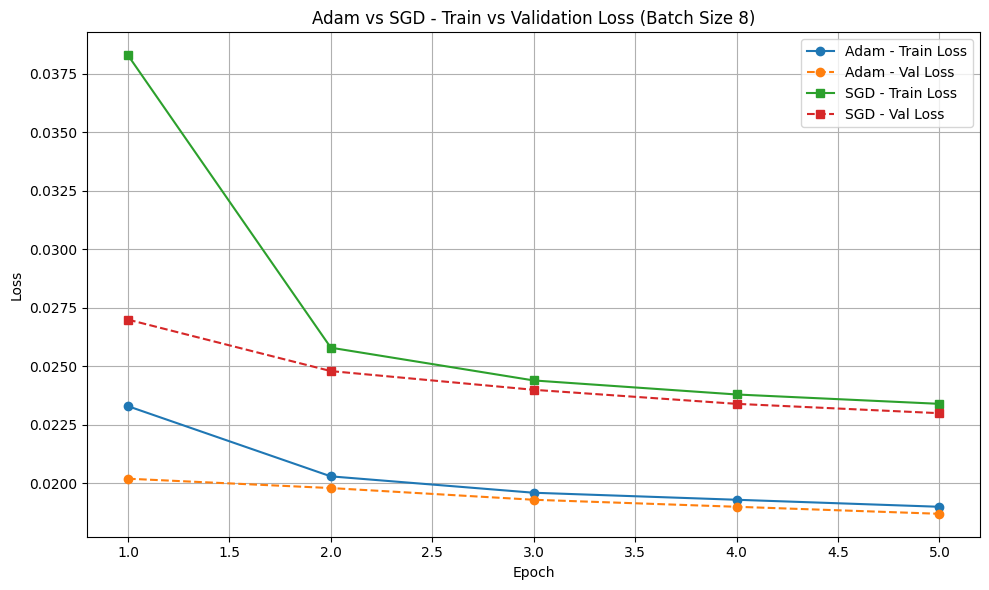

In [ ]:
import matplotlib.pyplot as plt


epochs = [1, 2, 3, 4, 5]


adam_bs8_train  = [0.0233, 0.0203, 0.0196, 0.0193, 0.0190]
sgd_bs8_train   = [0.0383, 0.0258, 0.0244, 0.0238, 0.0234]


adam_bs8_val = [0.0202, 0.0198, 0.0193, 0.0190, 0.0187]
sgd_bs8_val  = [0.0270, 0.0248, 0.0240, 0.0234, 0.0230]

plt.figure(figsize=(10, 6))
plt.plot(epochs, adam_bs8_train, 'o-', label="Adam - Train Loss")
plt.plot(epochs, adam_bs8_val, 'o--', label="Adam - Val Loss")
plt.plot(epochs, sgd_bs8_train, 's-', label="SGD - Train Loss")
plt.plot(epochs, sgd_bs8_val, 's--', label="SGD - Val Loss")

plt.title("Adam vs SGD - Train vs Validation Loss (Batch Size 8)")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


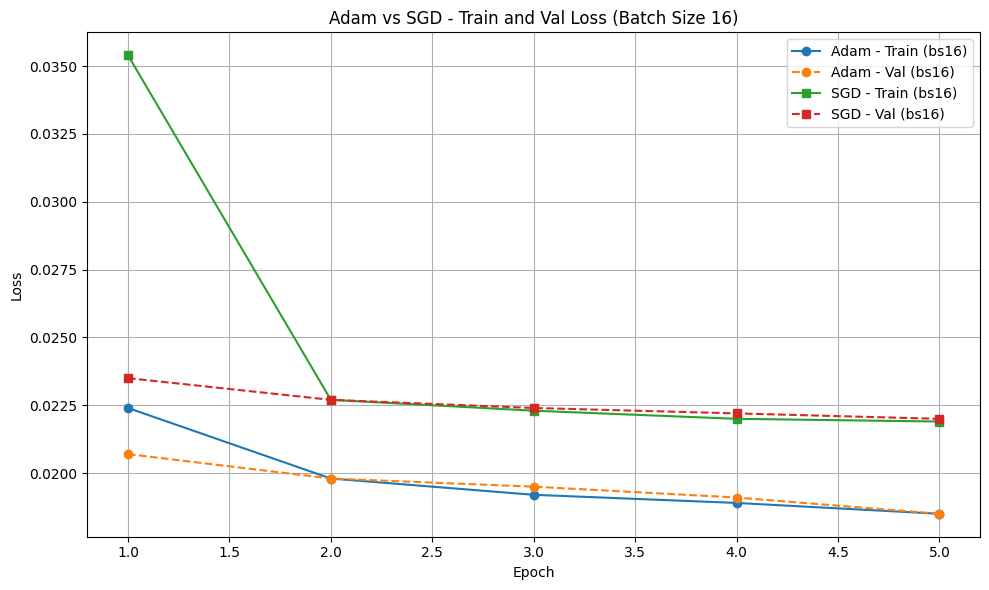

In [ ]:
import matplotlib.pyplot as plt

epochs = [1, 2, 3, 4, 5]


adam_bs16_train = [0.0224, 0.0198, 0.0192, 0.0189, 0.0185]
adam_bs16_val   = [0.0207, 0.0198, 0.0195, 0.0191, 0.0185]

sgd_bs16_train = [0.0354, 0.0227, 0.0223, 0.0220, 0.0219]
sgd_bs16_val   = [0.0235, 0.0227, 0.0224, 0.0222, 0.0220]

plt.figure(figsize=(10, 6))
plt.plot(epochs, adam_bs16_train, 'o-', label='Adam - Train (bs16)')
plt.plot(epochs, adam_bs16_val, 'o--', label='Adam - Val (bs16)')
plt.plot(epochs, sgd_bs16_train, 's-', label='SGD - Train (bs16)')
plt.plot(epochs, sgd_bs16_val, 's--', label='SGD - Val (bs16)')

plt.title("Adam vs SGD - Train and Val Loss (Batch Size 16)")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


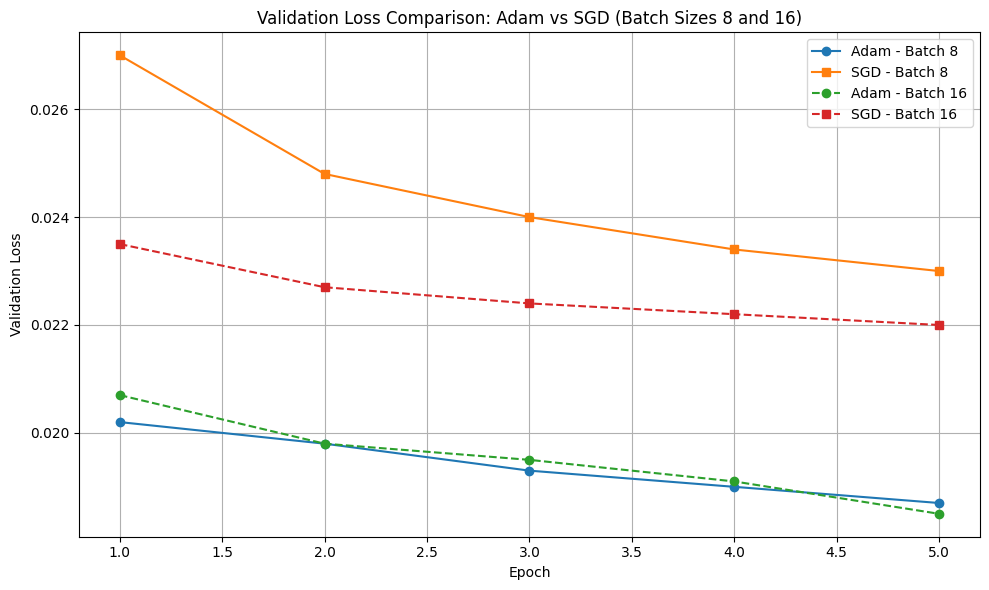

In [ ]:
import matplotlib.pyplot as plt


epochs = [1, 2, 3, 4, 5]


val_adam_bs8  = [0.0202, 0.0198, 0.0193, 0.0190, 0.0187]
val_sgd_bs8   = [0.0270, 0.0248, 0.0240, 0.0234, 0.0230]
val_adam_bs16 = [0.0207, 0.0198, 0.0195, 0.0191, 0.0185]
val_sgd_bs16  = [0.0235, 0.0227, 0.0224, 0.0222, 0.0220]


plt.figure(figsize=(10, 6))
plt.plot(epochs, val_adam_bs8, marker='o', label="Adam - Batch 8")
plt.plot(epochs, val_sgd_bs8, marker='s', label="SGD - Batch 8")
plt.plot(epochs, val_adam_bs16, marker='o', linestyle='--', label="Adam - Batch 16")
plt.plot(epochs, val_sgd_bs16, marker='s', linestyle='--', label="SGD - Batch 16")

plt.title("Validation Loss Comparison: Adam vs SGD (Batch Sizes 8 and 16)")
plt.xlabel("Epoch")
plt.ylabel("Validation Loss")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


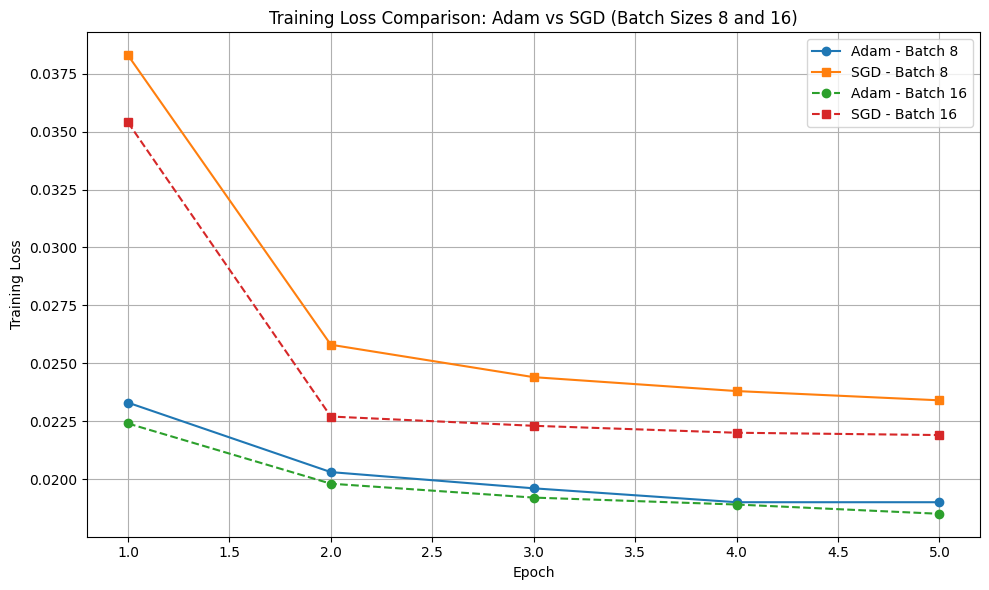

In [ ]:
import matplotlib.pyplot as plt

epochs = [1, 2, 3, 4, 5]


train_adam_bs8  = [0.0233, 0.0203, 0.0196, 0.0190, 0.0190]
train_sgd_bs8   = [0.0383, 0.0258, 0.0244, 0.0238, 0.0234]
train_adam_bs16 = [0.0224, 0.0198, 0.0192, 0.0189, 0.0185]
train_sgd_bs16  = [0.0354, 0.0227, 0.0223, 0.0220, 0.0219]


plt.figure(figsize=(10, 6))
plt.plot(epochs, train_adam_bs8, marker='o', label="Adam - Batch 8")
plt.plot(epochs, train_sgd_bs8, marker='s', label="SGD - Batch 8")
plt.plot(epochs, train_adam_bs16, marker='o', linestyle='--', label="Adam - Batch 16")
plt.plot(epochs, train_sgd_bs16, marker='s', linestyle='--', label="SGD - Batch 16")

plt.title("Training Loss Comparison: Adam vs SGD (Batch Sizes 8 and 16)")
plt.xlabel("Epoch")
plt.ylabel("Training Loss")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


**ADAM AND SGD OPTIMISER FOR 12 EPOCHS AND BATCH SIZE 8**

In [ ]:
#this code below trains and evaluates the model for 12 epochs for Adam and SGD optimiser and shows the results in tensorboard
from torch.utils.data import DataLoader, random_split
from torch.utils.tensorboard import SummaryWriter
import torch
import torch.nn as nn
import torch.optim as optim
import time



train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])


batch_size = 8
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size)


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
criterion = nn.MSELoss()


def train_model_tensorboard(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=12, optimizer_name="adam", batch_size=8):
    log_dir = f"runs/depth_{optimizer_name}_bs{batch_size}"
    writer = SummaryWriter(log_dir=log_dir)

    model.train()
    model.to(device)

    for epoch in range(num_epochs):
        train_loss = 0.0
        start_time = time.time()

        model.train()
        for images, depths in train_loader:
            images, depths = images.to(device), depths.to(device)

            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, depths)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        avg_train_loss = train_loss / len(train_loader)
        writer.add_scalar("Loss/train", avg_train_loss, epoch)


        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for images, depths in val_loader:
                images, depths = images.to(device), depths.to(device)
                outputs = model(images)
                loss = criterion(outputs, depths)
                val_loss += loss.item()

        avg_val_loss = val_loss / len(val_loader)
        writer.add_scalar("Loss/val", avg_val_loss, epoch)

        print(f"[{optimizer_name.upper()}] Epoch [{epoch+1}/{num_epochs}] - Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f} | Time: {time.time() - start_time:.2f}s")

    writer.close()
    print(" Training completed and TensorBoard logs saved.")


model = CNNDepthEstimator().to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-4)
train_model_tensorboard(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=12, optimizer_name="adam", batch_size=8)


model = CNNDepthEstimator().to(device)
optimizer = optim.SGD(model.parameters(), lr=1e-3, momentum=0.9)
train_model_tensorboard(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=12, optimizer_name="SGD", batch_size=8)


[ADAM] Epoch [1/12] - Train Loss: 0.0242 | Val Loss: 0.0204 | Time: 120.83s
[ADAM] Epoch [2/12] - Train Loss: 0.0207 | Val Loss: 0.0207 | Time: 117.28s
[ADAM] Epoch [3/12] - Train Loss: 0.0202 | Val Loss: 0.0192 | Time: 115.04s
[ADAM] Epoch [4/12] - Train Loss: 0.0199 | Val Loss: 0.0188 | Time: 116.59s
[ADAM] Epoch [5/12] - Train Loss: 0.0196 | Val Loss: 0.0188 | Time: 115.72s
[ADAM] Epoch [6/12] - Train Loss: 0.0194 | Val Loss: 0.0184 | Time: 116.29s
[ADAM] Epoch [7/12] - Train Loss: 0.0192 | Val Loss: 0.0183 | Time: 116.38s
[ADAM] Epoch [8/12] - Train Loss: 0.0190 | Val Loss: 0.0185 | Time: 116.45s
[ADAM] Epoch [9/12] - Train Loss: 0.0188 | Val Loss: 0.0181 | Time: 113.88s
[ADAM] Epoch [10/12] - Train Loss: 0.0187 | Val Loss: 0.0179 | Time: 113.82s
[ADAM] Epoch [11/12] - Train Loss: 0.0184 | Val Loss: 0.0178 | Time: 114.37s
[ADAM] Epoch [12/12] - Train Loss: 0.0184 | Val Loss: 0.0177 | Time: 113.46s
 Training completed and TensorBoard logs saved.
[SGD] Epoch [1/12] - Train Loss: 0.03

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 26372), started 1:24:49 ago. (Use '!kill 26372' to kill it.)

<IPython.core.display.Javascript object>

**ADAM AND SGD OPTIMISER FOR 12 EPOCHS AND BATCH SIZE 16**

In [ ]:
from torch.utils.data import DataLoader, random_split
from torch.utils.tensorboard import SummaryWriter
import torch
import torch.nn as nn
import torch.optim as optim
import time




train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])


batch_size = 16
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size)


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
criterion = nn.MSELoss()


def train_model_tensorboard(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=12, optimizer_name="adam", batch_size=16):
    log_dir = f"runs/depth_{optimizer_name}_bs{batch_size}"
    writer = SummaryWriter(log_dir=log_dir)

    model.train()
    model.to(device)

    for epoch in range(num_epochs):
        train_loss = 0.0
        start_time = time.time()

        model.train()
        for images, depths in train_loader:
            images, depths = images.to(device), depths.to(device)

            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, depths)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        avg_train_loss = train_loss / len(train_loader)
        writer.add_scalar("Loss/train", avg_train_loss, epoch)


        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for images, depths in val_loader:
                images, depths = images.to(device), depths.to(device)
                outputs = model(images)
                loss = criterion(outputs, depths)
                val_loss += loss.item()

        avg_val_loss = val_loss / len(val_loader)
        writer.add_scalar("Loss/val", avg_val_loss, epoch)

        print(f"[{optimizer_name.upper()}] Epoch [{epoch+1}/{num_epochs}] - Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f} | Time: {time.time() - start_time:.2f}s")

    writer.close()
    print(" Training completed and logs written to TensorBoard.")


model = CNNDepthEstimator().to(device)
optimizer = optim.Adam(model.parameters(), lr=5e-4)

train_model_tensorboard(model, train_loader, val_loader, criterion, optimizer, device,
                        num_epochs=12, optimizer_name="adam", batch_size=16)



model = CNNDepthEstimator().to(device)
optimizer_sgd = optim.SGD(model.parameters(), lr=5e-3, momentum=0.9)

train_model_tensorboard(model, train_loader, val_loader, criterion, optimizer_sgd, device,
                        num_epochs=12, optimizer_name="SGD", batch_size=16)


[ADAM] Epoch [1/12] - Train Loss: 0.0239 | Val Loss: 0.0195 | Time: 111.20s
[ADAM] Epoch [2/12] - Train Loss: 0.0194 | Val Loss: 0.0184 | Time: 112.85s
[ADAM] Epoch [3/12] - Train Loss: 0.0189 | Val Loss: 0.0213 | Time: 111.77s
[ADAM] Epoch [4/12] - Train Loss: 0.0185 | Val Loss: 0.0182 | Time: 110.83s
[ADAM] Epoch [5/12] - Train Loss: 0.0182 | Val Loss: 0.0177 | Time: 110.00s
[ADAM] Epoch [6/12] - Train Loss: 0.0181 | Val Loss: 0.0186 | Time: 109.50s
[ADAM] Epoch [7/12] - Train Loss: 0.0178 | Val Loss: 0.0172 | Time: 110.25s
[ADAM] Epoch [8/12] - Train Loss: 0.0177 | Val Loss: 0.0173 | Time: 110.21s
[ADAM] Epoch [9/12] - Train Loss: 0.0175 | Val Loss: 0.0177 | Time: 110.79s
[ADAM] Epoch [10/12] - Train Loss: 0.0174 | Val Loss: 0.0170 | Time: 110.87s
[ADAM] Epoch [11/12] - Train Loss: 0.0172 | Val Loss: 0.0171 | Time: 110.62s
[ADAM] Epoch [12/12] - Train Loss: 0.0171 | Val Loss: 0.0193 | Time: 110.70s
 Training completed and logs written to TensorBoard.
[SGD] Epoch [1/12] - Train Loss:

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 26372), started 2:09:01 ago. (Use '!kill 26372' to kill it.)

<IPython.core.display.Javascript object>

# VISUALISATION OF BATCH SIZE 8 AND 16 TRAINING AND VALIDATION LOSS FOR **12** EPOCHS

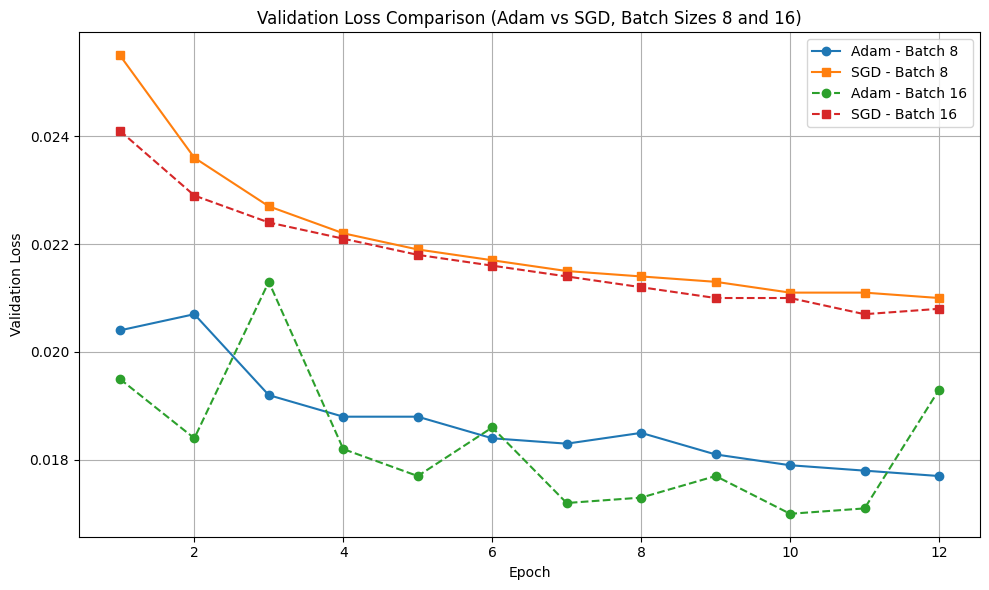

In [ ]:
import matplotlib.pyplot as plt


epochs = list(range(1, 13))


val_loss_adam_bs8 = [0.0204, 0.0207, 0.0192, 0.0188, 0.0188, 0.0184, 0.0183, 0.0185, 0.0181, 0.0179, 0.0178, 0.0177]
val_loss_sgd_bs8  = [0.0255, 0.0236, 0.0227, 0.0222, 0.0219, 0.0217, 0.0215, 0.0214, 0.0213, 0.0211, 0.0211, 0.0210]
val_loss_adam_bs16 = [0.0195, 0.0184, 0.0213, 0.0182, 0.0177, 0.0186, 0.0172, 0.0173, 0.0177, 0.0170, 0.0171, 0.0193]
val_loss_sgd_bs16  = [0.0241, 0.0229, 0.0224, 0.0221, 0.0218, 0.0216, 0.0214, 0.0212, 0.0210, 0.0210, 0.0207, 0.0208]


plt.figure(figsize=(10, 6))
plt.plot(epochs, val_loss_adam_bs8, marker='o', label="Adam - Batch 8")
plt.plot(epochs, val_loss_sgd_bs8, marker='s', label="SGD - Batch 8")
plt.plot(epochs, val_loss_adam_bs16, marker='o', linestyle='--', label="Adam - Batch 16")
plt.plot(epochs, val_loss_sgd_bs16, marker='s', linestyle='--', label="SGD - Batch 16")

plt.title("Validation Loss Comparison (Adam vs SGD, Batch Sizes 8 and 16)")
plt.xlabel("Epoch")
plt.ylabel("Validation Loss")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


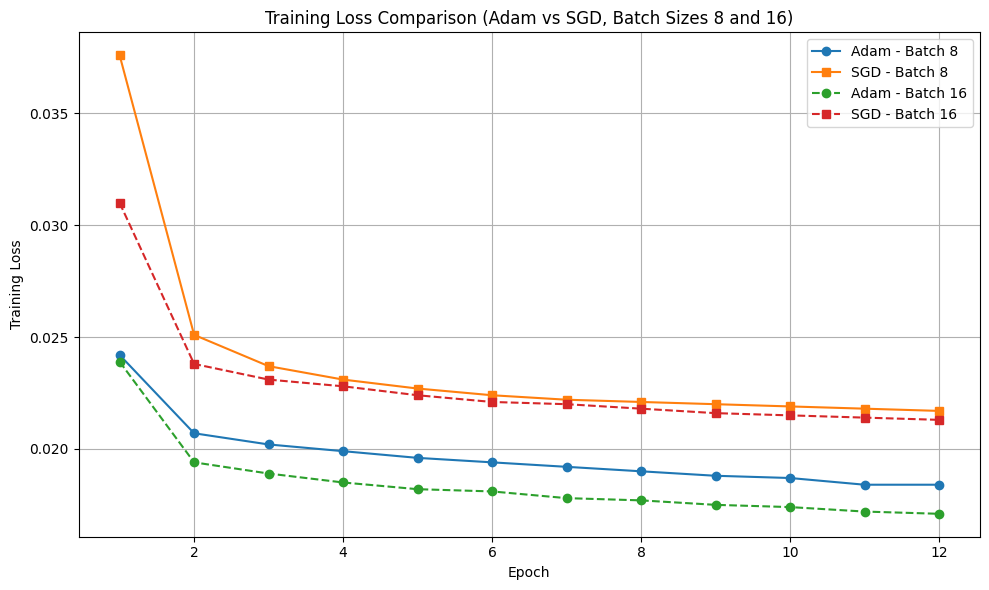

In [ ]:
import matplotlib.pyplot as plt


epochs = list(range(1, 13))


train_loss_adam_bs8 = [0.0242, 0.0207, 0.0202, 0.0199, 0.0196, 0.0194, 0.0192, 0.0190, 0.0188, 0.0187, 0.0184, 0.0184]
train_loss_sgd_bs8  = [0.0376, 0.0251, 0.0237, 0.0231, 0.0227, 0.0224, 0.0222, 0.0221, 0.0220, 0.0219, 0.0218, 0.0217]
train_loss_adam_bs16 = [0.0239, 0.0194, 0.0189, 0.0185, 0.0182, 0.0181, 0.0178, 0.0177, 0.0175, 0.0174, 0.0172, 0.0171]
train_loss_sgd_bs16  = [0.0310, 0.0238, 0.0231, 0.0228, 0.0224, 0.0221, 0.0220, 0.0218, 0.0216, 0.0215, 0.0214, 0.0213]


plt.figure(figsize=(10, 6))
plt.plot(epochs, train_loss_adam_bs8, marker='o', label="Adam - Batch 8")
plt.plot(epochs, train_loss_sgd_bs8, marker='s', label="SGD - Batch 8")
plt.plot(epochs, train_loss_adam_bs16, marker='o', linestyle='--', label="Adam - Batch 16")
plt.plot(epochs, train_loss_sgd_bs16, marker='s', linestyle='--', label="SGD - Batch 16")

plt.title("Training Loss Comparison (Adam vs SGD, Batch Sizes 8 and 16)")
plt.xlabel("Epoch")
plt.ylabel("Training Loss")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
